# Okavango_Scenario

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import sys
import matplotlib.patches as patches
from matplotlib.dates import date2num
import matplotlib.dates as mdates
from hydroeval import evaluator, nse, rmse, pbias
from pyemu.pst.pst_utils import SFMT,IFMT,FFMT
from tqdm import tqdm
import geopandas as gpd
from matplotlib.colors import TwoSlopeNorm
import matplotlib as mpl
import matplotlib.patheffects as path_effects

# Set Path

In [2]:
wd_base = "D:/Projects/Watersheds/Okavango/scenarios/okvg_swatmf_calibrated_base_result"
wd_bau = "D:/Projects/Watersheds/Okavango/scenarios/okvg_swatmf_scn_bau_new_results"





# Create Dataframe from output.hru

In [3]:
from swatmf_pkgs.swatmf_viz import read_output_mgt, read_output_hru, read_output_sed

# Read input.std to bring area and hru number

In [4]:
sed_base = read_output_sed(wd_base)

In [5]:
sed_base_f = pd.DataFrame()
for i in tqdm(range(1, 258)):
    df = sed_base.loc[sed_base['subs'] == i]
    df = df['sed']
    # df = df.groupby(['mon']).sum()
    # df = df.rename('rch_{:03d}'.format(i), inplace=True)
    df.rename(i, inplace=True)
    df.index = pd.date_range('1/1/2003',periods=len(df), freq='M')

    sed_base_f = pd.concat([sed_base_f, df], axis=1)
sed_base_f.index = pd.DatetimeIndex(sed_base_f.index).normalize()
adf = sed_base_f.resample('A').sum().mean()
adf.rename('base', inplace=True)

100%|██████████| 257/257 [00:01<00:00, 195.91it/s]


1       97367.398180
2      313983.670735
3      320300.109287
4      262412.112162
5      334364.865681
           ...      
253        11.858000
254         0.000000
255         0.000000
256        21.058824
257         0.000000
Name: base, Length: 257, dtype: float64

In [9]:
sed_bau = read_output_sed(wd_bau)
sed_bau_f = pd.DataFrame()
for i in tqdm(range(1, 258)):
    df = sed_bau.loc[sed_bau['subs'] == i]
    df = df['sed']
    df.rename(i, inplace=True)
    df.index = pd.date_range('1/1/2003',periods=len(df), freq='M')

    sed_bau_f = pd.concat([sed_bau_f, df], axis=1)
sed_bau_f.index = pd.DatetimeIndex(sed_bau_f.index).normalize()
abau = sed_bau_f.resample('A').sum().mean()
abau.rename('bau', inplace=True)


100%|██████████| 257/257 [00:01<00:00, 215.92it/s]


1      113210.783380
2      344186.340639
3      323944.153767
4      335446.855284
5      377656.437781
           ...      
253        12.527412
254         0.000000
255         0.000000
256        30.435295
257         0.000000
Name: bau, Length: 257, dtype: float64

In [10]:
dff = pd.concat([adf, abau], axis=1)
dff.index.name = 'Subbasin'

In [12]:
dff['diff'] = dff['bau'] - dff['base']
dff['diff_per'] = dff['diff']/dff['base']*100
dff

,base,bau,diff,diff_per
Subbasin,,,,
1,97367.398180,113210.783380,15843.385200,16.271756
2,313983.670735,344186.340639,30202.669904,9.619185
3,320300.109287,323944.153767,3644.044480,1.137697
4,262412.112162,335446.855284,73034.743122,27.832078
5,334364.865681,377656.437781,43291.572099,12.947405
...,...,...,...,...
253,11.858000,12.527412,0.669412,5.645233
254,0.000000,0.000000,0.000000,NaN
255,0.000000,0.000000,0.000000,NaN


# Mapping

In [31]:
subdf = gpd.read_file("D:/Projects/Watersheds/Okavango/Analysis/Reports/report12/sed.shp")
pts = gpd.read_file("D:/Projects/Watersheds/Okavango/Analysis/Reports/report12/label_prj.shp")

In [32]:
subdf = subdf.merge(dff, on='Subbasin')

In [36]:
# normalize color
# vmin, vmax, vcenter = dff.min().min(), dff.max().max(), 0
vmin, vmax, vcenter = dff['diff_per'].min(), dff['diff_per'].max(), 0
norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)
# create a normalized colorbar
cmap = 'RdBu_r'
cbar = plt.cm.ScalarMappable(norm=norm, cmap=cmap)

ipykernel_launcher:29: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


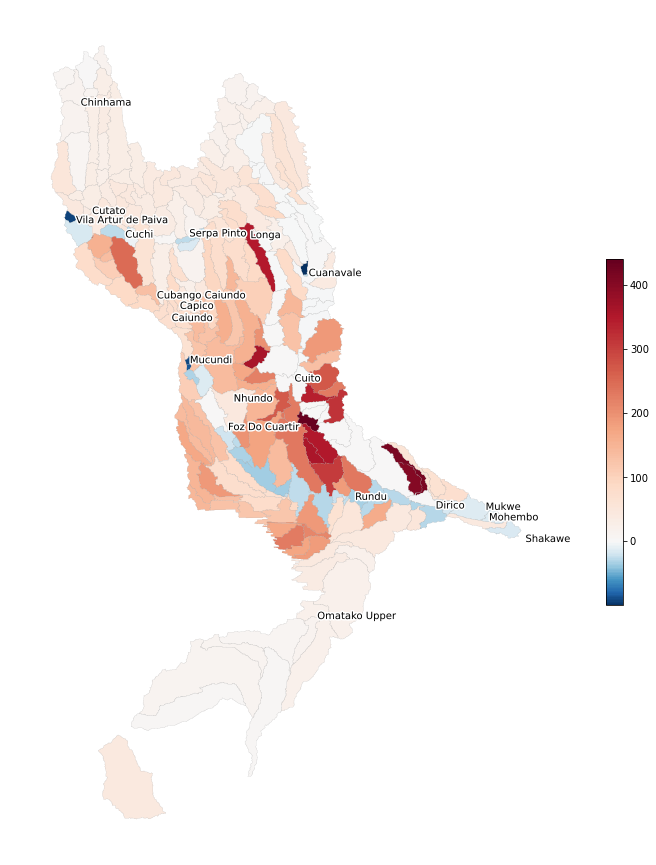

In [37]:
fig, ax = plt.subplots(
    figsize=(8,12),
                )
ax1 = fig.add_subplot(111, frameon=False)
ax1.axis('off')

subdf.plot(
    column='diff_per', ax=ax,  norm=norm, cmap=cmap, vmin=vmin, vmax=vmin,
    edgecolor="gray", linewidth=0.1)

for x, y, label in zip(pts.geometry.x, pts.geometry.y, pts.Gauge_name):
    text = ax.annotate(
                label, xy=(x, y), xytext=(1, 1), textcoords="offset points", fontsize=10,
                # weight='bold'
                )
    text.set_path_effects([path_effects.Stroke(linewidth=3, foreground='white'),
                       path_effects.Normal()])
    
ax.axis('off')
cbaxes = fig.add_axes([1.05, 0.3, 0.03, 0.4])

# mpl.rcParams['xtick.labelsize'] = 1
mpl.rcParams['ytick.labelsize'] = 10

cp = fig.colorbar(cbar, ax=ax1, orientation="vertical", cax=cbaxes)
# .set_label(label='Label',size=20,weight='bold')
# cbar.tick_params(labelsize=25) 
# cbar.cbaxes.tick_params(labelsize=10) 
fig.tight_layout()
# ax.legend()
plt.savefig('diff_perc.png', dpi=300, bbox_inches="tight")
plt.show()


In [49]:
dff.to_excel('sed.xlsx')

In [48]:
os.getcwd()

'd:\\spark-brc_gits\\swatmf_git'

# Monthly mapping

In [26]:
sed_base_f = pd.DataFrame()
for i in tqdm(range(1, 258)):
    df = sed_base.loc[sed_base['subs'] == i]
    df = df[['mons', 'sed']]
    df = df.groupby(['mons']).mean()
    df.rename(columns={'sed':i}, inplace=True)
    sed_base_f = pd.concat([sed_base_f, df], axis=1)


100%|██████████| 257/257 [00:00<00:00, 354.58it/s]


In [27]:
sed_base_f 

,1,2,3,4,5,6,7,8,9,10,...,248,249,250,251,252,253,254,255,256,257
mons,,,,,,,,,,,,,,,,,,,,,
1.0,25684.941176,78485.352941,84819.411765,61657.941176,81555.823529,26.116294,1.235424e+05,29.447000,26.403688,33.443542,...,38.120176,148.186765,2.302353e-10,8.284118,22.070588,0.340353,0.0,0.0,7.375882e-08,0.0
2.0,17479.882353,27587.417647,33257.411765,40135.176471,38170.705882,47.877733,5.709465e+04,56.834806,79.192224,68.126952,...,250.434647,799.814706,7.828235e-09,577.666824,1422.400588,11.517647,0.0,0.0,2.105882e+01,0.0
3.0,31383.370588,132006.035294,116453.647059,100829.288235,132698.882353,7.420247,2.138614e+05,5.800641,8.141829,13.772134,...,11.446824,25.668235,3.454118e-09,0.623564,0.000000,0.000000,0.0,0.0,2.529353e-07,0.0
4.0,10055.464647,43986.061765,38892.011176,33109.662941,41741.434706,0.783176,7.562955e+04,0.722834,9.605625,18.862637,...,0.954353,2.902688,4.604706e-10,0.000010,0.000000,0.000000,0.0,0.0,1.117076e-07,0.0
5.0,0.434006,2.030368,2.988518,62.361761,9.221956,0.001100,2.634673e+02,0.001580,0.001312,0.000974,...,0.038191,0.041733,0.000000e+00,0.000000,0.000000,0.000000,0.0,0.0,3.582529e-08,0.0
6.0,0.000000,0.000000,0.000000,0.004829,0.004581,0.000000,7.809706e-02,0.000000,0.000000,0.000000,...,0.000118,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.0,0.0,0.000000e+00,0.0
7.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.370588e-07,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.0,0.0,0.000000e+00,0.0
8.0,0.048744,0.029779,0.072710,0.013748,0.035203,0.000000,1.139571e-02,0.000000,0.000000,0.000000,...,0.000000,0.000000,9.211765e-10,0.000000,0.000000,0.000000,0.0,0.0,0.000000e+00,0.0
9.0,4.430488,9.406471,14.027471,4.287706,7.340412,0.013862,1.386994e+01,0.015878,0.015485,0.009659,...,0.004855,0.031919,3.914118e-09,0.000000,0.000000,0.000000,0.0,0.0,0.000000e+00,0.0


In [28]:
sed_bau = read_output_sed(wd_bau)
sed_bau_f = pd.DataFrame()
for i in tqdm(range(1, 258)):
    df = sed_bau.loc[sed_bau['subs'] == i]
    df = df[['mons', 'sed']]
    df = df.groupby(['mons']).mean()
    df.rename(columns={'sed':i, inplace=True)
    sed_bau_f = pd.concat([sed_bau_f, df], axis=1)


100%|██████████| 257/257 [00:00<00:00, 371.92it/s]


In [42]:
dff = (sed_bau_f.subtract(sed_base_f, fill_value=0))
dff = dff.T
month_names = ['Jan','Feb','Mar','Apr','May','Jun',
               'Jul','Aug','Sep','Oct','Nov','Dec']
dff.columns = month_names
dff.index.name = 'Subbasin'

In [81]:
subdf = gpd.read_file("D:/Projects/Watersheds/Okavango/Analysis/Reports/report12/sed.shp")

In [87]:
subdf = subdf.merge(dff, on='Subbasin')

In [88]:
subdf

,OBJECTID,GRIDCODE,Subbasin,Area,Slo1,Len1,Sll,Csl,Wid1,Dep1,...,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
0,1,1,1,4.535978e+04,1.715720,17648.945052,121.914051,0.090657,50.651496,1.501799,...,3.137635e+03,5.757236e+02,0.000024,0.000000,0.0,0.000000,0.000000,-0.002059,174.781294,6034.235294
1,2,2,2,6.102104e+04,2.122262,6406.173561,91.435538,0.187319,60.517011,1.690967,...,8.209176e+03,2.203895e+03,0.001036,0.000000,0.0,-0.000015,-0.006412,0.001176,7.479412,10453.411765
2,3,3,3,9.601434e+04,2.466742,28058.548345,91.435538,0.106919,79.431244,2.027112,...,-9.094706e+02,-2.398478e+03,-1.230329,0.000000,0.0,-0.072710,-14.027471,-48.700304,-1136.093529,10590.352941
3,4,4,4,6.431251e+04,2.413792,31730.618072,91.435538,0.296244,62.454968,1.726878,...,1.977353e+04,4.309949e+03,6.326929,-0.000008,0.0,0.000025,-0.007353,-0.008824,161.189412,23820.470588
4,5,5,5,2.104393e+04,2.652600,13378.726061,91.435538,0.321406,31.949633,1.104572,...,1.333388e+04,8.473000e+02,0.301466,-0.002505,0.0,-0.035050,-6.291459,-26.518471,-644.181882,20023.705882
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
252,253,253,253,3.920269e+05,1.332052,112774.252501,121.914051,0.096653,184.747773,3.558522,...,0.000000e+00,0.000000e+00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
253,254,254,254,1.759957e+06,0.426245,159339.833416,121.914051,0.096021,454.873888,6.488499,...,0.000000e+00,0.000000e+00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
254,255,255,255,4.371287e+04,0.309390,9928.556711,121.914051,0.080576,49.539918,1.479746,...,0.000000e+00,0.000000e+00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
255,256,256,256,5.658224e+05,1.013772,45546.756767,121.914051,0.085626,230.249033,4.121122,...,5.903235e-08,5.900412e-08,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000


In [89]:
# normalize color
vmin, vmax, vcenter = dff.min().min(), dff.max().max(), 0
norm = TwoSlopeNorm(vmin=vmin, vcenter=vcenter, vmax=vmax)
# create a normalized colorbar
cmap = 'RdBu_r'
cbar = plt.cm.ScalarMappable(norm=norm, cmap=cmap)

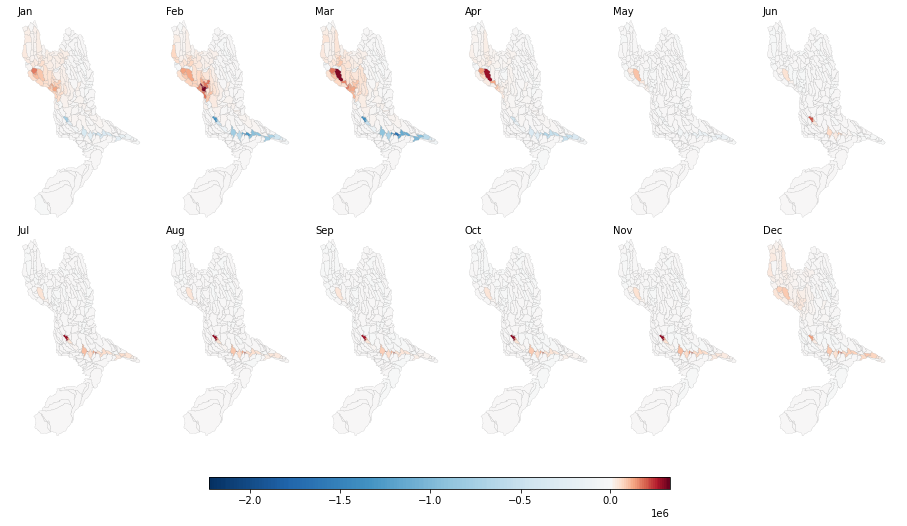

In [148]:
fig, axes = plt.subplots(
    2, 6, figsize=(16,8),
    gridspec_kw={
                'hspace': 0.01,'wspace': 0.01
                })
ax1 = fig.add_subplot(111, frameon=False)
ax1.axis('off')
for ax, j in zip(axes.flat, month_names):
    # sub_dis_shp.plot(column='Id',ax=ax)
    subdf.plot(
        column=j, ax=ax,  norm=norm, cmap=cmap, vmin=vmin, vmax=vmin,
        edgecolor="gray", linewidth=0.1)
    
    ax.axis('off')
    ax.text(0.01, 0.98, j, transform=ax.transAxes, ha='left',fontsize=10,)
cbaxes = fig.add_axes([0.3, 0.05, 0.4, 0.02])


# mpl.rcParams['xtick.labelsize'] = 10
# mpl.rcParams['ytick.labelsize'] = 10

cp = fig.colorbar(cbar, ax=ax1, orientation="horizontal", cax=cbaxes)
# .set_label(label='Label',size=20,weight='bold')
# cbar.tick_params(labelsize=25) 
# cbar.cbaxes.tick_params(labelsize=10) 
# fig.tight_layout()
# ax.legend()
plt.savefig('month.png', dpi=300)
plt.show()


# cb=plt.colorbar(im,orientation='horizontal').set_label(label='Label',size=20,weight='bold')

